In [5]:
import unittest
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

In [6]:
# Miscellaneous utilities for bquadform.py
#
# Use this code only for prototyping

# integer square root (floor)
# reference: Algorithm 1.7.1 (p.38) of Cohen -
# "A Course in Computational Algebraic Number theory" (GTM 138)
def isqrt(n):
    if not isinstance(n, int):
        raise TypeError("input is not integer")
    if n < 0:
        raise ValueError("input is negative")
    if n == 0:
        return 0
    # [Initialize]
    x = 1 << (n.bit_length() + 2 >> 1)
    while True:
        # [Newtonian step]
        y = (x + n // x) >> 1
        # [Finished?]
        if y >= x:
            return x
        x = y

# # integer square root (ceiling)
# def isqrt_ceil(n):
#     if n == 0:
#         return 0
#     else:
#         return 1 + isqrt(n - 1)

# Euclidean division: always ensures that
# 0 <= r < |b| regardless of sign of divisor
def divmod_euclid(a, b):
    q, r = divmod(a, b)   # divmod uses floor division
    if r < 0:
        q += 1
        r -= b
    return (q, r)

# extended Euclidean algorithm (assumes a >= 0 & b >= 0)
# reference: Algorithm 1.3.6 (p.16) of Cohen -
# "A Course in Computational Algebraic Number theory" (GTM 138)
def ext_euclid(a, b, u=1, v1=0):
    # [Initialize]
    d = a
    # v to be computed in ext_euclid_front()
    if b == 0:
        return (u, d)
    v3 = b
    # [Finished?]
    while v3 != 0:
        # [Euclidean step]
        q, t3 = divmod(d, v3)
        t1 = u - q * v1
        u = v1
        d = v3
        v1 = t1
        v3 = t3
    # [Finished?] cont. moved to ext_euclid_front()
    return (u, d)

# extended partial Euclidean algorithm
# reference: Sub-algorithm PARTEUCL(a, b) (p. 248) of Cohen -
# "A Course in Computational Algebraic Number theory" (GTM 138)
def part_euclid(d, v3, v, v2, L):
    # [Initialize]
    z = 0
    # [Finished?]
    while abs(v3) > L:
        # [Euclidean step]
        q, t3 = divmod_euclid(d, v3)
        t2 = v - q * v2
        v = v2
        d = v3
        v2 = t2
        v3 = t3
        z += 1
    # [Finished?] cont. moved to part_euclid_front()
    return (v, d, v2, v3, z)

# most significant digit of a, and the value of b in same place
# in base M (assumes a >= b, a >= 0, and b >= 0)
def same_msd(a, b, M):
    while a >= M:
        a //= M
        b //= M
    return a, b

# Lehmer extended (assumes a >= b, a >= 0, and b >= 0)
# reference: Algorithm 1.3.7 (p. 17) of Cohen -
# "A Course in Computational Algebraic Number theory" (GTM 138)
def lehmer(a, b, M):
    # [Initialize]
    u = 1
    v1 = 0
    # [Finished?]
    while b >= M:
        a_hat, b_hat = same_msd(a, b, M)
        A = 1
        B = 0
        C = 0
        D = 1
        # [Test quotient]
        while not (b_hat + C == 0 or b_hat + D == 0):
            q = (a_hat + A) // (b_hat + C)
            if q != ((a_hat + B) // (b_hat + D)):
                break
            # [Euclidean step]
            T = A - q * C
            A = C
            C = T
            T = B - q * D
            B = D
            D = T
            T = a_hat - q * b_hat
            a_hat = b_hat
            b_hat = T
        # [Multi-precision step]
        if B == 0:
            q, t = divmod(a, b)
            a = b
            b = t
            t = u - q * v1
            u = v1
            v1 = t
        else:
            t = A * a + B * b
            r = C * a + D * b
            a = t
            b = r
            t = A * u + B * v1
            r = C * u + D * v1
            u = t
            v1 = r
    return a, b, u, v1

# "frontend" for extended Euclidean algorithm
def ext_euclid_front(a, b, use_lehmer=True, M=(1 << 32)):
    # init: the algorithms assume that a >= 0 & b >= 0
    orig_a = a
    orig_b = b
    if orig_a < 0:
        a = -a
    if orig_b < 0:
        b = -b
    # execute algorithms
    if use_lehmer and a < b:
        at = a
        bt = b
        b, a, u, v1 = lehmer(b, a, M)
        u, d = ext_euclid(b, a, u, v1)
        v = u
        u = (d - bt * v) // at   # [Finished?] cont. of Euclid Extended
    elif use_lehmer:
        at = a
        bt = b
        a, b, u, v1 = lehmer(a, b, M)
        u, d = ext_euclid(a, b, u, v1)
        v = (d - at * u) // bt   # [Finished?] cont. of Euclid Extended
    else:
        u, d = ext_euclid(a, b)
        v = (d - a * u) // b   # [Finished?] cont. of Euclid Extended
    # final: check sign of orig a & b
    if orig_a < 0:
        a = -a
        u = -u
    if b < 0:
        b = -b
        v = -v
    return (u, v, d)

# "frontend" for extended partial Euclidean algorithm
def part_euclid_front(d, v3, v, v2, L):   # TODO: use_lehmer=True, M=(1 << 32)
    # execute algorithms
    v, d, v2, v3, z = part_euclid(d, v3, v, v2, L)
    # final: [Finished?] cont. of PARTEUCL
    if z % 2 == 1:
        v2 = -v2
        v3 = -v3
    return (v, d, v2, v3, z)

In [7]:
class BQuadForm:
    def __init__(self, a, b, c=None, disc=None):
        if (c == None and disc == None) or (c != None and disc != None):
            raise AttributeError("invalid arguments")
        if not (isinstance(a, int) and isinstance(b, int)):
            raise TypeError("'a' or 'b' is not integer")
        # optional: check if a < 0 to detect non-positive-definiteness

        if c != None:
            if not isinstance(c, int):
                raise TypeError("'c' is not integer")
            # c is given, so compute discriminant
            disc = b * b - ((a * c) << 2)
            if disc >= 0:
                raise ValueError("non-negative discriminant")

        elif disc != None:
            if not isinstance(disc, int):
                raise TypeError("'disc' is not integer")
            if disc >= 0:
                raise ValueError("non-negative discriminant")
            # disc is given, so compute c
            c, c_test = divmod(b * b - disc, a << 2)   # a is assumed positive
            if c_test != 0:
                raise TypeError("'c' is not integer")

        # optional: check if gcd(a, b, c) != 1 to detect non-primitiveness
        self.a = a
        self.b = b
        self.c = c
        self.disc = disc
        self.L = isqrt(isqrt(abs(disc) >> 2))   # 4th root of |disc/4|
        # only work with reduced forms
        self.__reduction()

    # reduction of positive definite forms
    # reference: Algorithm 5.4.2 (p.243) of Cohen -
    # "A Course in Computational Algebraic Number theory" (GTM 138)
    def __reduction(self):
        # [Initialize]: if -a < b <= a goto [Finished?]
        if -self.a < self.b and self.b <= self.a:
            self.__reduction_finished()
            return
        self.__reduction_euclidean()
        self.__reduction_finished()

    # [Euclidean step] in reduction of positive definite forms
    def __reduction_euclidean(self):
        # let b = 2aq + r with 0 <= r < 2a be the Euclidean division of b by 2a
        q, r = divmod_euclid(self.b, self.a << 1)
        # if r > a, set r = r - 2a, q = q + 1 (i.e. we want b = 2aq + r, where -a < r <= a)
        if r > self.a:
            r -= self.a << 1
            q += 1
        # then set c = c - (1/2)(b + r)q, b = r
        self.c -= ((self.b + r) * q) >> 1
        self.b = r

    # [Finished?] in reduction of positive definite forms
    def __reduction_finished(self):
        while not self.isReduced():
            # if a > c set b = -b, exchange a and c and goto [Euclidean step]
            if self.a > self.c:
                self.b = -self.b
                self.a, self.c = self.c, self.a
                self.__reduction_euclidean()
            # otherwise, if a = c and b < 0, set b = -b
            elif self.a == self.c and self.b < 0:
                self.b = -self.b

    # check if the positive definite form is reduced
    # reference: Definition 5.3.2 (p.231) of Cohen -
    # "A Course in Computational Algebraic Number theory" (GTM 138)
    def isReduced(self):
        abs_b = abs(self.b)
        # |b| < a < c
        if abs_b < self.a and self.a < self.c:
            return True
        # |b| = a and b >= 0
        if abs_b == self.a and self.b >= 0:
            return True
        # a = c and b >= 0
        if self.a == self.c and self.b >= 0:
            return True
        return False

    # equality
    def __eq__(self, y):
        if isinstance(y, BQuadForm):
            return self.a == y.a and self.b == y.b and self.c == y.c and self.disc == y.disc
        raise TypeError("syntax error")

    # string representation
    def __repr__(self):
        return str((self.a, self.b, self.c)) + " disc: " + str(self.disc)

    # inverse of primitive quadratic form
    # reference: p.250 of Cohen -
    # "A Course in Computational Algebraic Number theory" (GTM 138)
    def inverse(self):
        return BQuadForm(self.a, -self.b, self.c)

    # identity element := BQuadForm * BQuadForm.inverse()
    def identity(self):
        return self * self.inverse()

    # composition (NUCOMP algorithm)
    # reference: Algorithm 5.4.9 (p.249) of Cohen -
    # "A Course in Computational Algebraic Number theory" (GTM 138)
    def __mul__(self, y):
        if not isinstance(y, BQuadForm):
            raise TypeError("syntax error")
        if self.disc != y.disc:
            raise ValueError("discriminants are different")
        # [Initialize]
        if self.a > y.a:
            a1 = self.a
            b1 = self.b
            c1 = self.c
            a2 = y.a
            b2 = y.b
            c2 = y.c
        else:    # if a1 < a2 exchange f1 and f2
            a1 = y.a
            b1 = y.b
            c1 = y.c
            a2 = self.a
            b2 = self.b
            c2 = self.c
        s = (b1 + b2) >> 1
        n = b2 - s
        # [First Euclidean step]
        u, v ,d = ext_euclid_front(a2, a1)
        if s % d == 0:   # if d|s
            A = -u * n
            d1 = d
            if d != 1:
                a1 //= d1
                a2 //= d1
                s //= d1
        else:   # if not d|s
            # [Second Euclidean step]
            u1, v1, d1 = ext_euclid_front(s, d)
            if d1 > 1:
                a1 //= d1
                a2 //= d1
                s //= d1
                d //= d1
            # [Initialization of reduction]
            l = (-u1 * (u * (c1 % d) + v * (c2 % d))) % d
            A = -u * (n // d) + l * (a1 // d)
        # [Partial reduction]
        A %= a1
        A1 = a1 - A
        if A1 < A:
            A = -A1
        # input sequence: d, v3, v, v2, L = bound
        v, d, v2, v3, z = part_euclid_front(a1, A, 0, 1, self.L)
        # [Special case]
        if z == 0:
            Q1 = a2 * v3
            Q2 = Q1 + n
            f = Q2 // d
            g = (v3 * s + c2) // d
            a3 = d * a2
            # c3 = v3 * f + g * d1   # not required if disc is provided
            b3 = 2 * Q1 + b2
            return BQuadForm(a3, b3, disc = self.disc)
        # [Final computations]
        b = (a2 * d + n * v) // a1
        Q1 = b * v3
        Q2 = Q1 + n
        f = Q2 // d
        e = (s * d + c2 * v) // a1
        Q3 = e * v2
        Q4 = Q3 - s
        g = Q4 // v
        if d1 > 1:
            v2 *= d1
            v *= d1
        a3 = d * b + e * v
        # c3 = v3 * f + g * v2   # not required if disc is provided
        b3 = Q1 + Q2 + d1 * (Q3 + Q4)
        return BQuadForm(a3, b3, disc = self.disc)

    # squaring (NUDUPL algorithm)
    # reference: Algorithm 5.4.8 (p.248) of Cohen -
    # "A Course in Computational Algebraic Number theory" (GTM 138)
    def square(self):
        a = self.a
        b = self.b
        c = self.c
        # [Euclidean step]
        u, _, d1 = ext_euclid_front(b, a)
        A = a // d1
        B = b // d1
        C = (- c * u) % A
        C1 = A - C
        if C1 < C:
            C = -C1
        # [Partial reduction]
        # input sequence: d, v3, v, v2, L = bound
        v, d, v2, v3, z = part_euclid_front(A, C, 0, 1, self.L)
        # [Special case]
        if z == 0:
            g = (B * v3 + c) // d
            a2 = d * d
            # c2 = v3 * v3 + g * d1   # not required if disc is provided
            b2 = b + 2 * d * v3   # simplified
            return BQuadForm(a2, b2, disc = self.disc)
        # [Final computations]
        e = (c * v + B * d) // A
        g = (e * v2 - B) // v
        b2 = e * v2 + v * g
        if d1 > 1:
            b2 *= d1
            v *= d1
            v2 *= d1
        a2 = d * d + e * v
        # c2 = v3 * v3 + g * v2   # not required if disc is provided
        b2 += 2 * d * v3   # simplified
        return BQuadForm(a2, b2, disc = self.disc)

    # exponentiation using Non-Adjacent Form (NAF) of an integer
    # reference: Algorithm 3.1 (p.27) of Sayles -
    # "Improved Arithmetic in the Ideal Class Group of Imaginary Quadratic Number Fields
    # with an Application to Integer Factoring"
    def __pow__(self, y):
        if not (isinstance(y, int) and y >= 0):
            raise TypeError("syntax error")
        c = 0
        T = self
        R = self.identity()
        # note: instead of using counter i for the while loop, I used right-shifting of y instead
        rsh_y = y
        while rsh_y > 0:
            twobit_test = (rsh_y + c) % 4
            if twobit_test == 1:
                R *= T
                c = 0
            elif twobit_test == 3:
                R *= T.inverse()
                c = 1
            T = T.square()
            rsh_y >>= 1
        if c == 1:
            R *= T
        return R

In [8]:
discriminant = -5507
rangeA = 100
rangeB = 100
cnt = 1 # number of equivalent binary quadratic forms
reducedFormsWithCnt = {}
classGroups = np.zeros((rangeA, rangeB))
# Discriminant = b^2-4*a*c
for a in range(1,rangeA):
    for b in range(0,rangeB):
        if (b*b-discriminant)%(4*a) == 0:
            c = (b*b-discriminant)//(4*a)
            if b*b-4*a*c == discriminant:
                myForm = BQuadForm(a,b,c)
                myForm.a=a
                myForm.b=b
                myForm.c=c
                myhash = hash(str(a)+"domainA"+str(b)+"domainB"+str(c))
                if myForm.isReduced() and (myhash not in reducedFormsWithCnt):
                    reducedFormsWithCnt[myhash]=cnt
                    classGroups[a][b]=cnt
                    cnt+=1
                    #print("Reduced",a,b,c)
                if myForm.isReduced() and (myhash in reducedFormsWithCnt):
                    classGroups[a][b]=reducedFormsWithCnt[myhash]
                    #print("Reduced",a,b,c)
                if not myForm.isReduced():
                    myForm._BQuadForm__reduction()
                    myhash = hash(str(myForm.a)+"domainA"+str(myForm.b)+"domainB"+str(myForm.c))
                    if myhash not in reducedFormsWithCnt:
                        reducedFormsWithCnt[myhash]=cnt
                        classGroups[a][b]=cnt
                        cnt+=1
                        #print("Non-reduced",a,b,c)
                    else:
                        classGroups[a][b]=reducedFormsWithCnt[myhash]
                        #print("Non-reduced",a,b,c)
                
                
                #print(a,b,myForm,myForm.isReduced(),str(hash(tuple(myForm))))
                #print(a,b,b*b-discriminant//(4*a),myForm._BQuadForm__reduction())
                #cnt+=1
print(cnt)

24


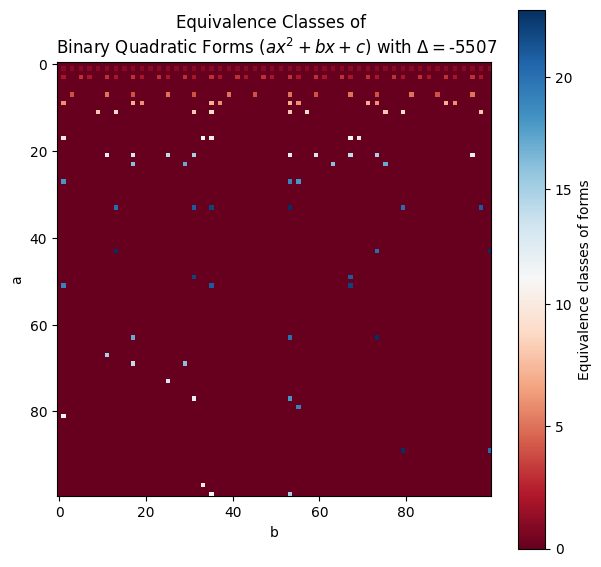

In [12]:
fig = plt.figure(figsize=(7, 7))

ax = fig.add_subplot(111)
ax.set_title("Equivalence Classes of \n Binary Quadratic Forms $(ax^2+bx+c)$ with $\Delta=$"+str(discriminant))
plt.xlabel("b")
plt.ylabel("a")
norm = mcolors.TwoSlopeNorm(vmin=classGroups.min(), vmax = classGroups.max(), vcenter=classGroups.max()//2)
plt.imshow(classGroups,cmap=plt.cm.RdBu, norm=norm)
ax.set_aspect('equal')
cbar = plt.colorbar(orientation='vertical')
cbar.set_label('Equivalence classes of forms')
plt.savefig("./Figures/existingFormsWithDiscriminant.pdf")

In [20]:
# Large Prime Generation for RSA
import random
 
# Pre generated primes
first_primes_list = [2, 3, 5, 7, 11, 13, 17, 19, 23, 29,
                     31, 37, 41, 43, 47, 53, 59, 61, 67,
                     71, 73, 79, 83, 89, 97, 101, 103,
                     107, 109, 113, 127, 131, 137, 139,
                     149, 151, 157, 163, 167, 173, 179,
                     181, 191, 193, 197, 199, 211, 223,
                     227, 229, 233, 239, 241, 251, 257,
                     263, 269, 271, 277, 281, 283, 293,
                     307, 311, 313, 317, 331, 337, 347, 349]
 
 
def nBitRandom(n):
    return random.randrange(2**(n-1)+1, 2**n - 1)
 
 
def getLowLevelPrime(n):
    '''Generate a prime candidate divisible 
    by first primes'''
    while True:
        # Obtain a random number
        pc = nBitRandom(n)
 
        # Test divisibility by pre-generated
        # primes
        for divisor in first_primes_list:
            if pc % divisor == 0 and divisor**2 <= pc:
                break
        else:
            return pc
 
 
def isMillerRabinPassed(mrc):
    '''Run 50 iterations of Rabin Miller Primality test'''
    maxDivisionsByTwo = 0
    ec = mrc-1
    while ec % 2 == 0:
        ec >>= 1
        maxDivisionsByTwo += 1
    assert(2**maxDivisionsByTwo * ec == mrc-1)
 
    def trialComposite(round_tester):
        if pow(round_tester, ec, mrc) == 1:
            return False
        for i in range(maxDivisionsByTwo):
            if pow(round_tester, 2**i * ec, mrc) == mrc-1:
                return False
        return True
 
    # Set number of trials here
    numberOfRabinTrials = 50
    for i in range(numberOfRabinTrials):
        round_tester = random.randrange(2, mrc)
        if trialComposite(round_tester):
            return False
    return True

In [10]:
## Orbit of a quadratic binary form by multiplying with a SL(Z,2) matrix

In [11]:
## Visualizing the class group operation via visualizing repeated squaring

In [13]:
## take 10000 random class groups and double them and see the original and the squared class groups mod different primes

In [21]:
prime_candidate = 2
while True:
        n = 30
        prime_candidate = getLowLevelPrime(n)
        if not isMillerRabinPassed(prime_candidate):
            continue
        else:
            print(n, "bit prime is: \n", prime_candidate)
            break

30 bit prime is: 
 922584317


In [35]:
myDiscriminant = -prime_candidate
print("My discriminant is:",myDiscriminant,myDiscriminant%4)
residue = 3 ## not necessarily a prime

My discriminant is: -922584317 3


In [ ]:
k = 10
for i in range(1,10000):
    found = False
    while not found:
        b = random.randrange(2**(k-1)+1, 2**k - 1)
        a = random.randrange(2**(k-1)+1, 2**k - 1)
        residueMod4 = (b*b-myDiscriminant) % (4*a)
        print(residueMod4)
        if residueMod4 == 0:
            c = b*b-myDiscriminant//4
            #print("yo",ac)
            break

2826
1321
201
1318
1014
1306
3309
1953
1550
2553
2318
321
993
1438
2010
2910
1961
801
2126
1233
2493
1129
1373
2770
113
3110
517
1622
3085
3162
822
1661
845
1861
606
1598
2286
1533
2198
2502
985
666
1181
1782
230
1782
566
3318
2417
645
1037
105
365
33
2445
2681
573
846
2206
645
2301
1614
2022
2081
406
3342
450
1121
45
878
774
1761
825
3633
1070
1830
2350
2281
1805
894
2561
3617
2098
2770
1905
2222
3386
326
3438
2246
765
393
609
1509
278
1838
558
901
1021
2249
4073
2358
1877
1533
937
454
1713
1533
1621
1305
1801
337
1518
2537
2281
1062
1286
318
2553
2386
1829
333
1601
749
737
862
1241
3294
670
2958
2214
621
62
1881
265
878
1941
2826
1574
1250
849
2134
1282
398
1982
1558
881
121
1101
1406
1253
269
114
449
2505
2478
1206
1697
1209
1374
1838
30
1697
2085
3678
1326
625
1470
1930
1854
1894
2358
3201
1678
902
270
262
1694
2901
614
2553
1382
77
2822
246
329
306
2497
1258
225
1762
2693
678
1265
2326
846
1062
470
1173
1254
1033
494
1890
342
1293
2522
2177
2341
2189
2393
1766
2654
717
1766
1926
1

1889
1533
1254
278
2441
246
2822
1014
1098
818
501
1726
3102
1846
669
942
246
357
873
1230
366
3113
1614
2913
1473
1918
557
3961
1161
125
1185
2710
438
1557
1686
1601
965
1182
438
86
1789
965
77
2561
2198
262
54
2493
818
3409
1965
797
2142
462
1149
645
1961
770
833
482
1905
1850
2298
2017
441
1389
3678
1826
317
1142
686
1037
657
701
1741
1742
1
174
1581
1254
133
2661
1078
2885
3650
2517
1206
3310
185
150
2157
1665
2273
898
2238
321
1350
566
801
2494
3093
425
1382
1601
1625
1373
378
2393
1230
2246
1581
445
1098
957
982
1269
1478
1282
1697
2557
3545
621
2438
462
2454
2030
318
1246
1062
2046
558
2106
1125
1301
1302
1062
1161
90
657
429
1742
2177
2066
642
86
1566
1961
1281
1978
1414
3297
1725
765
2166
1102
1238
865
1314
558
369
2510
2357
469
2953
2673
25
1094
3302
2374
1209
1934
1217
2230
2081
2685
814
505
2374
1366
1797
2677
913
1554
2145
1278
701
961
621
854
765
1790
1821
2541
525
286
1622
657
1857
1349
1478
1761
1293
2329
585
3542
2253
1273
1302
806
1030
798
1670
198
1430
1242
2873
734


406
174
1533
46
941
1742
2990
798
941
1273
785
438
3422
1469
702
1181
1678
2169
2182
1213
418
610
358
1234
1241
2285
798
681
738
1017
1302
257
3718
2566
665
1302
1934
285
470
2050
538
2525
2738
118
3158
1342
1086
45
3782
894
1697
2126
3398
742
957
621
609
1654
502
2129
3846
293
781
2413
1866
926
1014
321
269
1877
2878
2813
110
549
785
1845
102
237
974
1845
1961
1278
1029
566
198
1926
2237
2313
150
513
686
1470
1358
2470
558
513
321
1745
2274
2270
886
1798
813
2458
1838
2742
465
326
2974
134
849
1734
1885
142
2894
594
1357
2973
3029
2406
1890
1001
733
1737
890
862
2246
1297
1958
1745
525
870
2422
969
886
2586
1026
237
142
1293
1666
2493
17
266
3282
1373
3366
218
1086
921
1954
1245
2033
1209
1518
438
1062
1854
3182
1761
1249
573
2182
1929
3206
78
2318
2021
1414
797
777
1758
1153
2734
846
1382
3078
1497
17
522
725
1526
885
1073
2693
1665
1042
522
1662
1657
522
614
422
3138
1021
462
438
1829
973
725
3118
1837
1002
2037
2397
1865
2734
1454
2302
1553
1214
177
2037
1934
1317
2693
3830
1270
71

3677
158
3073
1662
1941
1273
398
2161
933
1613
1597
1013
537
1346
1341
1678
2438
1942
345
2294
1533
826
1286
1726
337
1794
1317
198
1121
1757
1777
1305
510
1517
3821
782
106
1950
374
550
1742
2734
1149
474
1866
961
1038
1189
2041
2485
453
758
157
1742
1313
1326
2178
2046
1477
1110
2361
677
1981
142
1686
1454
2701
62
3166
1702
3481
2237
58
2258
2605
1946
1341
1533
2793
1086
341
1590
1286
1741
3881
1190
78
842
301
221
2306
234
1017
1833
66
654
1921
1550
3857
477
2694
822
678
2694
3821
1053
1766
1242
3701
789
1286
2721
1294
1242
1518
1313
2045
758
957
1913
1461
1341
1382
573
4002
1374
285
2045
770
2806
78
518
2177
1182
3009
590
1846
1389
174
2982
534
1026
1886
2518
966
2658
977
1094
2154
1126
846
2066
1005
3473
1746
213
333
413
1761
1413
2206
1554
105
2905
157
837
1206
2706
654
2597
166
2133
1277
2274
246
793
941
3118
1933
1526
2685
981
2193
3489
2830
2034
22
1141
1034
1793
1353
1502
1238
781
2317
761
941
2813
630
1405
2142
1469
2894
1910
1581
1569
678
1394
802
1761
581
1518
2230
417
921


3017
97
1806
1837
2201
2385
2694
710
886
153
773
598
2242
3286
1533
3081
798
2062
2934
1009
1058
2830
94
2186
1614
109
3521
110
3641
1529
3021
1373
22
1077
461
1281
449
2934
1370
142
1605
1902
3606
2793
2529
2361
2025
645
2753
1473
2274
1678
701
1545
1553
626
873
906
393
2361
2373
146
1838
3957
617
1469
3910
1381
534
1534
3246
1094
2970
822
821
582
2033
1973
2106
601
2906
1626
3182
1121
549
1265
966
1758
2381
1373
2886
62
846
1501
1742
2309
1118
1329
1401
1593
2550
945
3318
1165
1089
918
1153
1286
946
30
1278
3217
2353
1086
1193
1110
62
737
5
1741
1953
677
2742
1566
1285
1502
113
3206
526
2057
1214
1857
3093
2598
2881
3029
1949
2386
1750
2333
2426
358
1886
157
766
1513
1077
209
726
678
2522
1758
2397
3406
33
2241
3210
3750
2453
1373
181
153
1653
86
3158
1278
3054
193
2673
622
822
1533
1862
1742
1350
737
1041
3393
729
2974
149
469
3677
2721
1261
1597
217
3670
2841
3614
1846
2254
678
3165
2345
1254
198
3221
3389
1010
882
893
601
1838
1278
1594
165
2033
1038
394
797
1614
1462
1702
206
207

2973
697
798
2254
2817
2778
1317
2370
53
2565
877
554
2958
1085
2646
2853
1238
2862
2001
490
2678
3582
3133
550
1053
2073
2022
2589
293
693
3998
3353
1125
862
669
2173
2914
2589
1981
105
3022
726
2622
2458
2454
1073
3137
1581
2730
1681
2822
65
510
1854
870
2074
2029
2829
2345
1713
1538
3722
2342
225
2494
2798
374
54
761
1742
2477
2517
581
1246
281
1038
3102
2926
1849
1202
2753
2045
2337
894
1725
589
2561
1790
1801
78
1926
2741
2241
797
2981
1854
573
2454
385
2062
2073
554
2826
2542
574
3958
653
1558
1746
1694
2226
846
2070
1565
2157
486
1093
2445
1278
809
2145
758
381
2394
609
1633
2622
558
1733
377
321
1073
1569
2193
2841
202
1734
1377
1278
3265
6
2358
2097
2541
2077
842
1149
1638
642
54
310
426
442
2913
1497
21
929
1237
1018
1581
1441
246
3174
1681
1601
1238
2953
518
2857
2685
513
2306
3726
3277
1062
1822
1461
2165
33
501
453
1057
326
113
3313
2849
2465
345
485
2926
522
2146
3057
1173
561
1517
1162
2490
2398
2078
2390
2406
630
2881
545
173
1378
3014
957
110
1461
1373
1625
2486
794
26

286
2073
141
3038
789
998
1798
1361
2002
1658
510
1462
158
3165
2757
1382
3174
341
1717
534
1733
2345
2574
1230
2054
862
510
2145
1042
2133
105
661
446
1990
453
1341
2421
1566
3702
1441
2941
1929
894
638
2989
2134
685
1597
989
2721
802
573
365
73
2110
1722
1622
1233
2390
537
2697
3294
1734
1082
1813
1065
1302
697
2134
1418
3005
1489
1238
513
557
2325
194
2309
69
3261
1749
1453
1221
86
2645
2998
2057
54
1830
2926
2569
545
1193
3357
1390
1766
1614
438
3373
513
2325
581
2022
1813
1622
878
414
3025
942
2849
1185
2798
2973
1641
1029
2617
590
1437
1385
1461
118
185
521
1798
1130
333
661
365
1534
629
2001
230
1629
2066
573
2081
1197
45
845
2110
1074
377
129
1286
2029
942
2573
621
3557
1166
1926
2397
630
453
1361
1782
321
3153
2658
2270
878
2166
2373
74
330
1510
2241
1734
6
2637
1366
1777
2766
1293
2185
1626
1533
957
1886
566
2702
2078
126
942
1865
2129
2501
737
2229
1685
886
2238
2349
1509
713
1965
2966
153
1221
2390
2829
1590
2606
2073
2497
2038
2682
1650
1114
842
2513
1997
881
454
1189
505


2482
1398
2602
2013
34
1398
834
2798
2426
177
2625
2234
1721
685
1846
654
2233
1317
302
1714
1110
3042
473
1594
1313
1166
1742
286
2442
609
846
2257
182
1269
2158
2826
1793
1238
393
1833
1313
1898
1181
3102
1841
1390
2594
3041
1133
69
509
918
2741
2838
1377
110
558
1093
1961
2125
1334
1054
1449
1581
1454
2349
318
1073
274
338
674
561
2278
662
297
1041
2241
2166
2566
894
2001
2381
793
2557
1998
909
2382
238
1653
1290
1486
1410
3537
2786
897
1830
1889
477
38
921
705
1725
217
165
2093
1205
758
3273
1037
438
441
646
2797
1001
909
177
1053
2694
257
957
2134
1201
3326
2694
1333
2045
614
942
3161
3073
678
2958
3705
2493
673
2885
65
2593
142
158
1150
3158
390
810
342
309
1861
2745
3729
1438
681
878
1510
3622
642
1349
1745
2061
854
77
1797
185
3281
485
2445
906
801
833
630
1089
1233
2118
438
225
1038
449
606
814
2273
2381
754
1242
1074
1197
1902
1310
22
3542
1153
1981
1861
686
1473
961
1601
33
678
1013
77
1605
1801
2677
601
1922
14
2934
1037
3093
166
1742
3141
3430
3750
1601
2293
1633
1533
2973

2829
1326
326
1605
1517
701
1057
822
1805
1382
417
2093
18
1742
2286
2661
417
2374
790
766
438
1742
1918
522
1538
2622
2246
2105
262
2777
509
2073
2441
2541
2510
1022
977
1113
1917
545
574
1398
1401
1489
374
2505
606
1561
2486
1138
2809
565
1830
2785
2369
1949
3385
1701
2049
1086
1290
1302
2022
1461
3849
769
309
78
2041
1133
1133
381
1758
2049
942
361
997
2257
198
3270
77
2870
878
870
2706
2286
1413
1041
2758
181
606
2614
2329
61
1214
3018
846
2050
2294
398
806
2261
2646
1894
2362
1302
1718
14
1122
474
2873
526
594
2230
1793
2337
746
2985
278
1102
2237
2462
2321
2622
1073
2125
22
717
665
1758
1778
2718
1558
2646
3382
829
1894
554
738
110
1670
2577
2190
557
2825
301
1294
53
606
1821
2129
957
29
2541
1081
773
182
453
2765
117
237
1114
1566
606
1941
301
2245
1998
3134
826
113
2073
858
833
141
585
2102
3582
2242
886
1713
1653
2365
1898
590
2074
2870
1489
1505
2889
2886
978
814
1750
2129
2245
833
870
1542
2685
3198
1298
1953
510
1025
241
701
798
926
1841
1770
762
1181
1893
3070
186
1106
163

126
1870
1254
806
1601
494
2102
1809
3597
3169
398
1845
102
354
629
1505
3486
2161
2510
1686
158
1798
929
2253
1818
525
1405
1790
306
2262
2625
446
317
557
1305
1393
1922
601
53
2397
2066
606
1650
3569
157
545
1149
1494
3170
1965
3246
2118
1089
734
1682
2066
905
2561
574
3618
1878
2018
2257
2274
1733
221
2021
2966
1701
630
945
2421
2033
650
510
766
1358
1377
1089
1702
2878
330
2237
2653
2061
229
1985
478
349
1421
277
1822
2561
2317
1773
3642
1229
1602
701
2301
2374
2414
1062
78
105
3685
2337
2086
222
82
1057
1385
1038
1925
366
1837
794
2881
2458
3241
405
230
1373
1661
1086
3065
845
2489
1806
21
61
1642
1530
2798
2189
2745
825
110
2405
1333
493
941
1218
1878
294
1729
93
1761
1530
1038
166
1314
438
3173
2
785
194
1853
865
70
366
518
3738
3289
798
3405
2169
1281
3213
221
1678
1281
1593
2101
3122
1241
226
1142
2966
1934
606
1686
3245
1406
246
2689
706
2418
1134
1293
2346
214
506
302
1874
2441
1437
557
1078
1761
682
3541
1458
2217
302
1077
2173
2601
1161
2574
917
809
1478
2533
1038
334
2786

2941
1637
1325
1958
1758
1161
2849
273
1329
741
1745
2577
3309
1830
1993
766
2609
1437
3518
3606
1025
1742
138
2470
853
3794
2373
2141
1177
3889
3198
129
1529
1441
2493
422
2094
2505
2422
341
733
929
2190
1838
2413
630
1662
2049
2894
365
965
1697
1657
941
1278
1133
1778
1074
1433
1793
1794
285
1909
1198
3462
2049
1041
1153
1901
1837
2562
1598
2058
678
1318
2982
2201
2937
430
2433
362
2630
1917
497
1797
2125
2181
1674
810
2302
502
3425
366
1601
6
726
3253
2334
2697
1677
2182
2393
2738
2230
2502
37
65
2322
897
429
1797
1814
1369
753
873
189
1633
417
2342
2021
2706
777
1686
3601
2718
1782
673
2974
1178
486
2429
918
3078
1686
2134
326
2942
1098
921
78
97
2409
1381
3217
77
2717
1193
1942
1170
1901
1314
2734
1054
1302
1902
1518
2069
157
1726
2602
793
957
237
1077
3521
1845
1497
398
606
737
661
2541
1501
1398
877
65
3414
2433
1074
294
317
1814
846
2442
3670
526
726
2334
2182
1390
2534
1537
1902
2198
1006
1886
158
333
2978
277
642
2949
345
166
3110
333
2682
1517
758
2778
73
270
1166
945
638
87

593
750
401
1005
3293
825
950
2677
2497
870
366
1998
1993
957
1121
1813
1101
1630
2646
2125
2254
294
789
314
198
3597
169
1917
1134
3054
1038
2190
138
3241
957
2141
718
2013
1646
2145
933
2253
318
310
190
5
441
2825
2901
1626
705
678
1293
422
1250
998
1126
3310
2309
730
429
1718
2433
1614
2798
2769
633
918
1746
917
1505
641
1237
1886
618
1177
1149
2957
1341
945
3862
2694
1049
2301
373
1109
1278
1317
209
190
3805
1713
3994
3078
1813
1121
1686
2822
2061
1582
461
373
1486
2558
1278
994
1118
2977
1250
2358
2002
470
674
1734
2333
2034
1253
2593
106
78
1610
1733
2826
517
1309
1422
258
2478
2486
694
793
2510
2129
2161
541
1985
1830
2574
3038
2649
2829
2961
2177
2390
3325
137
214
762
742
813
734
2006
1758
998
2701
169
842
726
2433
641
1065
462
1926
625
2010
2869
545
2297
1966
1850
2606
381
1406
777
398
385
878
1425
3133
2638
661
1757
2445
2142
30
1613
1334
1910
2317
3357
2029
1070
3437
1606
1198
2121
2274
838
285
1041
2878
1181
509
1374
1662
3321
741
898
1041
1110
1790
2862
1266
2006
198
2593


50
1485
3093
1046
958
914
657
461
377
2630
2405
493
1697
1581
3017
502
285
2870
837
1033
881
489
833
2346
2726
2893
2986
6
2177
957
1153
3246
1926
574
2214
3541
2873
1998
2514
1289
1518
598
1886
89
2118
2374
2322
317
293
1646
3277
182
422
765
3321
1238
726
673
1230
62
2686
285
2209
1517
3889
1014
2849
3493
174
653
974
613
3213
169
1725
25
2094
90
2545
1806
2013
57
2637
3246
1534
2742
29
377
777
2190
1337
1826
1645
2102
398
506
1101
177
2805
621
2253
1505
1089
957
873
2529
3606
2953
225
850
2113
597
3350
3293
1841
1086
2625
2309
2798
2025
2562
2110
589
645
3254
1826
486
1318
1797
914
1193
797
1294
1357
102
1809
2682
113
929
2462
2202
2309
1218
1322
2249
2582
3597
865
686
798
3181
450
3317
2245
2113
318
3973
1661
1601
2122
157
802
1130
1482
1037
1034
2638
2997
189
565
3058
2238
1437
917
1361
1222
1265
1350
1941
1517
1262
3897
3169
641
273
1321
3078
2029
1801
3329
3009
797
593
1730
3717
2226
2513
1089
2502
2497
61
2973
526
1294
385
1846
1665
1662
2001
2574
2557
709
2422
1249
1233
2814
176

326
30
2274
3318
2013
3530
742
2121
2526
926
2653
581
217
1686
2518
2897
2442
841
1853
2501
2977
2157
1246
2286
2637
485
1421
1918
257
2474
1813
1262
213
1281
1782
1261
2654
113
1713
2073
993
1673
1421
9
3206
806
381
3201
89
1713
2105
1386
1209
2466
242
1837
1809
1593
1658
1158
1077
1006
1998
913
406
478
1470
2294
285
1441
1581
1221
1230
1613
1381
585
174
1798
2005
874
2541
1681
3598
1862
141
2758
3577
1926
1622
2334
1338
2406
1478
2197
1806
1014
497
1217
918
357
762
542
957
573
2478
2462
1830
3062
1558
813
1494
1390
926
2646
1533
2417
1949
2325
21
1166
1574
2141
177
822
641
2478
1454
2521
934
942
2398
2970
526
725
3162
1693
3638
2490
1693
2741
2897
1742
937
2006
438
973
993
2481
678
2509
590
2721
1497
1013
561
854
1142
2378
253
682
681
1542
766
138
1446
2085
1441
385
1953
1682
118
2281
2325
837
2310
1966
2685
741
1646
2565
126
2286
1242
2806
2046
17
1661
2105
582
438
626
798
2786
2061
97
262
3117
3273
846
513
250
1925
2633
1302
3582
618
466
2782
2022
674
2041
1469
1341
597
410
1446
23

989
1233
581
653
2070
3437
1622
117
398
1929
1526
2114
353
1541
778
2381
3518
1326
426
1513
1538
902
2826
681
1470
2381
2233
1505
1577
2045
2333
1085
1353
2266
1662
2598
1469
2090
398
1173
1413
573
2006
582
622
222
1833
630
909
761
2501
3150
2202
1389
1378
1965
993
126
426
2301
1238
1233
1954
2229
362
1481
957
1833
517
1862
110
846
214
1078
2441
986
2550
1253
1278
297
1917
2993
549
1857
589
717
1805
1117
1350
846
2685
797
3957
2070
2998
1542
2493
2582
3418
541
1913
417
518
1049
814
2745
993
2962
2181
1950
1417
1929
1902
2037
2937
366
1337
285
1854
3137
1726
2946
1118
2913
1557
2649
2694
3094
61
1710
1445
1041
2554
1005
201
497
614
3309
3517
1494
2774
2241
634
3582
350
1294
2517
2433
1373
1038
177
2966
749
3185
2993
1169
654
158
1245
1481
2618
1118
2094
1214
1833
737
486
486
766
1117
3182
593
1537
446
62
110
542
1185
1462
81
1170
1421
1206
3089
1293
582
2513
113
1297
505
854
557
1373
2190
489
3397
3241
2646
1134
93
1422
1025
1178
2261
2202
258
806
1121
1350
2574
2141
2513
1998
966
1217


1590
2845
2605
1038
2301
73
2214
1965
1369
1065
2214
318
201
2017
438
1606
2782
294
1525
865
2133
2273
3189
2558
473
946
1782
270
110
2125
2585
2541
1530
2157
174
1522
3238
2069
1862
2817
2805
754
3561
625
1502
1342
977
769
189
181
189
846
358
1274
2277
638
1638
2033
758
1841
318
1550
1878
2421
2133
1986
1742
969
213
1846
1749
797
1958
3153
3846
2433
1074
534
3806
1265
989
326
2785
278
1581
3434
174
1866
3537
2934
1902
2237
2342
2541
2829
2486
1153
2501
1806
558
2277
1642
417
577
594
126
1965
2166
2634
1133
38
2573
1713
41
113
1678
1510
609
3678
2606
1206
1753
1934
1689
3749
621
110
694
1481
545
2902
2970
421
558
2745
334
397
557
1497
1313
3486
1518
1181
521
1930
286
1630
506
1994
2670
781
1089
1302
1461
333
1445
1085
454
78
2462
2894
1981
594
1373
3502
3177
2502
1105
2441
3501
2373
513
301
2433
2990
1661
2337
1254
2062
1806
374
614
3206
1750
1805
641
1518
2433
2357
3306
2553
2078
2017
2046
1342
3061
821
2537
1725
1857
2706
1218
2486
993
2702
1546
1390
2289
501
3649
1049
1269
2065
1425

1861
1217
2469
1874
1462
1058
1238
2102
1726
50
1022
830
150
194
1358
3401
1213
518
2030
1206
2934
1613
726
446
869
1217
98
257
578
2013
3722
174
1102
138
3686
2442
1806
2510
1041
1334
237
990
2758
2373
126
2621
2502
833
1661
1257
1869
3898
1486
2630
1237
870
333
1833
1077
126
977
2621
2622
2081
318
53
1537
3722
1654
2514
1217
1365
2041
1574
1994
1342
1333
3429
398
86
506
145
1046
2146
86
153
1982
693
3730
3682
2042
813
3221
417
697
3182
257
1846
845
481
737
2001
1326
2246
334
842
1193
2077
1517
1809
1301
1454
2078
2558
106
1750
3262
65
658
533
669
890
657
1129
574
1678
1257
249
2550
841
2998
1329
2673
2457
1733
1022
777
1941
982
2709
862
2354
1094
1290
13
3518
934
1170
1726
614
1517
2270
597
2518
1110
846
2326
1118
753
2045
2461
526
466
1741
1030
1590
1781
273
862
1086
529
1665
3005
705
1630
1121
785
849
1053
2001
1406
837
1441
3494
2313
2910
937
961
506
1742
1938
2514
2458
2458
366
390
1013
2057
1257
2493
3166
2478
621
1769
2382
893
2566
2454
1185
158
2413
1878
265
1793
177
2526
4038

878
1089
834
2613
533
3569
1790
714
3414
2526
2694
1041
258
446
3202
1497
33
1353
422
22
853
1533
1017
317
3426
1649
561
3006
589
2617
401
1358
2121
2414
1062
69
1118
2070
645
2217
185
1601
1389
854
1918
606
2058
777
1406
3749
1709
1545
3318
602
3317
1725
2673
1230
542
1101
2913
505
2006
1829
2133
1622
2833
33
141
2077
1581
2417
982
2925
789
3281
2262
554
1582
398
1713
486
1897
3014
1774
481
858
2309
3158
321
565
657
2433
2321
822
2230
365
3470
1086
201
2282
1793
1541
453
190
373
182
158
1313
3153
1310
957
2542
2481
1470
1782
3777
3542
758
250
2682
1061
2145
161
957
2333
1538
1233
1038
846
2077
1009
3133
3013
94
3030
674
2781
1301
1941
1985
994
1613
333
981
1934
2445
1478
146
566
1805
1521
398
2421
742
502
2649
758
53
1261
561
1410
2918
273
717
1197
818
2857
2093
1413
2966
2417
2066
1942
561
849
1961
642
1501
1274
1089
1329
225
2094
61
909
2514
1990
2366
2314
3246
670
1693
1830
1137
2253
1993
798
321
66
201
46
2306
1234
2578
1661
510
926
838
854
2906
1646
2493
2878
1406
417
2573
2225
1

114
1686
2442
1778
2486
2525
90
33
134
1774
817
1262
2757
2893
1201
669
609
2717
1726
4002
3062
2694
806
878
474
2862
846
381
1701
2253
2430
1441
1166
3030
257
761
929
1469
1826
1686
1769
693
221
1869
2077
174
1890
1569
1629
2273
2062
1409
349
3126
2490
2306
1518
530
1805
846
3473
833
2046
3222
2121
2557
286
2817
1706
433
1581
1278
1121
1713
2006
1798
2542
1405
1406
2526
309
2238
2658
1026
225
1757
582
2046
694
1222
961
1110
2142
981
529
1958
1421
2038
1054
1845
293
1293
245
1182
1830
2353
1141
3166
1798
1206
2310
2965
1041
1885
54
1761
2822
1026
2141
3797
334
1441
2306
2814
798
462
1190
505
2154
718
1206
409
1633
2045
669
1445
1121
230
2057
1686
770
1154
2678
2286
2082
130
3686
733
621
589
1841
1689
1285
2605
1982
2374
2897
2274
446
1614
2294
1710
1790
1302
1209
381
3414
1601
318
1625
1605
1486
1470
1677
1905
1898
1553
909
49
238
165
1377
750
1977
1485
1314
738
2502
2693
1721
173
110
1841
878
206
2154
1422
2873
617
2586
2541
2625
1329
1665
1601
205
1217
617
158
2385
1618
230
1902
474


3438
1797
2005
1862
2574
2294
1838
674
109
2278
129
381
2657
3198
2358
1905
286
1377
1925
3433
1313
289
2958
2273
2577
993
401
2621
145
2169
2577
806
1625
1677
542
2621
1769
270
177
2634
905
1021
2734
3997
797
1401
169
926
133
2310
1454
2373
2269
885
2022
1646
2185
893
1281
609
2294
1601
2550
1998
590
2138
3413
1046
161
126
2042
230
2769
693
1782
3393
1146
2209
2766
2305
873
2358
762
1678
2461
2733
349
393
638
2577
2966
326
1801
3345
670
66
1966
2238
2473
521
510
954
501
270
3117
1745
597
150
33
961
1206
1697
2157
1482
702
401
266
3366
321
1441
1525
1422
1734
3921
1150
194
2001
2210
2097
2478
1782
1614
2385
2402
2121
1753
33
2177
317
2654
2318
1697
3369
1062
2022
1533
3254
894
2894
1594
78
2070
1345
262
902
113
1906
861
658
2337
942
973
734
509
2542
2070
461
1649
970
1005
1938
654
1390
1209
2486
1101
2542
1313
441
265
989
1089
141
3057
2094
2070
1062
1262
682
553
461
1462
2178
1337
1797
881
609
510
1601
1913
1373
1709
558
22
1530
2646
2666
98
1942
2769
1357
77
2813
1101
1958
1405
2701


3246
1626
2238
2358
749
1441
134
573
82
1034
766
1486
257
2285
173
2126
2273
2446
1526
1230
3213
1725
1210
257
2246
386
2970
221
313
113
494
461
870
2593
574
2230
206
817
321
1533
2909
2009
245
993
2141
77
3378
1206
1326
1606
1281
1709
2466
329
2430
2170
2982
1910
566
3189
318
825
1350
3062
1253
798
449
2541
450
1942
1814
509
3422
2430
294
3462
2141
710
1205
1446
437
602
2861
301
2465
1630
2897
1770
1142
645
185
585
1569
990
2286
321
1041
2629
202
2781
334
2133
138
3046
2181
3214
3262
1798
2157
2785
1997
2494
1441
3901
1030
1381
553
1157
638
345
857
2677
509
866
2522
2501
2477
1621
1313
3209
1005
1630
1614
2706
1497
3102
725
2225
1314
1273
1409
1974
30
3382
1169
1498
1581
458
2022
3177
1022
2509
3289
53
861
162
426
1769
1326
2297
518
1469
465
302
3182
2438
1345
2493
2345
2446
3282
822
1565
2758
2613
1001
1522
1050
2337
2337
1038
126
2430
858
1809
2806
2402
2774
637
569
1833
1782
1401
13
1253
1125
374
1617
1470
829
1182
450
1998
1697
777
1665
102
2753
2293
1238
526
294
1334
318
342
486


941
1462
2046
1098
2057
1430
2918
2742
1341
2685
2822
1110
150
1833
1709
1437
2037
1998
2118
2378
297
3226
1158
2177
30
1933
1253
3038
361
901
2478
1265
2822
390
3321
2466
1326
446
597
1050
610
2686
417
3021
141
1286
2973
1962
430
22
1246
1694
2574
1049
1277
342
2565
2273
2113
2758
2382
673
3277
3378
2170
753
2694
2586
994
2061
1070
110
3930
1277
2061
2166
2670
793
1553
817
1818
1286
2066
2941
837
1846
1017
1226
1306
1829
317
974
1293
638
3062
1830
918
1846
109
1098
1338
182
2398
2934
1377
573
985
1602
2673
30
3821
1841
1773
110
1249
2070
1281
833
581
86
670
477
758
1782
1369
1309
1869
1686
2086
1001
3498
3402
449
333
2021
353
3642
1869
2381
2326
3118
1614
1665
1898
1646
406
1249
1590
225
2073
2497
3113
1974
2601
1537
1917
1273
1373
2441
2706
2706
2422
2333
366
2933
517
1345
2902
1106
3293
193
773
1238
1933
2713
2902
2373
781
2718
737
1777
3294
1238
2014
665
622
1542
414
410
2162
1062
2721
1902
2677
2417
3302
750
2154
1377
1821
1041
3498
2874
1294
478
38
481
1653
3150
2418
1353
174
321

2057
1214
1909
798
249
1290
2437
2097
2501
1653
2606
1645
1133
1266
781
1494
1530
1062
3498
1933
2193
2097
2166
1534
2397
1705
342
1965
998
565
761
2817
2357
433
1901
2073
2813
2593
1177
989
2006
2146
2646
461
1174
2966
1249
710
617
2321
3269
1525
822
641
1326
1706
809
649
1874
1102
2061
813
2238
429
3497
797
2973
1777
461
2285
1670
1318
1902
246
1157
1402
1533
3090
1662
1046
1473
1478
898
2357
1629
1238
2485
858
1778
2817
1166
2178
2406
525
2129
1629
2358
726
270
2154
142
2230
526
2342
2838
1866
2438
1706
2277
1773
2949
1885
1182
2022
3158
117
2218
1926
1598
2622
2481
2685
2445
2361
2822
2001
554
1734
1341
1633
3149
293
590
453
885
1741
1701
1030
2321
2145
934
365
2289
1293
393
2798
2109
2221
2049
69
1581
705
1326
1682
186
105
125
3381
1653
3566
1266
1350
2273
801
2205
2901
2270
2029
3326
2766
1929
2682
2017
2165
2525
1522
1021
694
1958
1166
158
813
3798
2238
3678
2253
438
3381
393
841
2430
862
2966
3789
1046
801
1761
1821
274
633
2045
2390
1193
2062
910
2518
1830
669
869
966
2045
606

2982
2302
930
990
617
782
2326
3281
1689
1002
3582
1618
1386
2853
1822
470
401
2237
689
1430
278
2001
3273
1497
1005
1733
2317
2670
878
3238
2218
198
913
2654
1334
2085
346
621
2102
2001
1397
1393
1610
1633
1197
414
870
1413
1142
1598
2778
505
613
302
1521
45
345
2113
2622
554
1742
365
2357
2618
1678
3030
2334
2538
510
1597
2221
3478
922
374
2494
3414
985
1478
2077
686
781
2721
417
2526
1841
2601
1825
3225
1437
2877
2841
2241
590
422
1421
486
1538
3481
685
2738
62
2118
894
870
2290
622
1546
1590
1854
225
205
2178
2062
1910
1958
1029
2417
2993
1697
1113
2677
422
626
1765
2030
1454
1122
1345
1598
2874
2274
542
9
1373
1725
2466
1350
230
2706
1846
1469
1094
3046
410
590
1714
2253
1758
2966
505
1758
2361
3489
1322
2141
849
1842
837
1566
2257
582
3798
957
2346
1278
509
561
2842
2697
2113
81
1086
1533
2086
770
510
941
2734
897
878
3625
2358
2886
77
86
2150
958
390
2998
1866
2006
2977
249
901
606
1098
1454
1197
2086
78
897
877
1293
1821
2054
1605
1853
2717
1761
2601
861
2966
3366
2001
3537
180

817
1630
81
1789
1518
414
1617
1734
3162
237
1529
474
134
198
1470
285
978
998
346
934
909
2025
2822
2253
2386
158
3437
1470
613
497
1086
1778
2605
526
3177
2118
3001
1186
3557
309
2006
2566
1110
2689
2361
141
3054
1950
738
1441
2241
2214
721
1661
633
2561
870
366
2214
22
1582
913
590
441
1249
201
1373
1918
1501
689
3913
1030
1374
1413
2057
426
297
2406
894
1305
882
78
1534
1629
174
461
2206
597
1094
1401
342
1334
221
2757
1209
222
2201
886
1233
1593
1958
498
2286
2110
30
2405
2037
1201
2266
1278
565
2553
510
1550
518
2193
950
1030
2126
1422
1473
3201
2333
1454
293
1494
3102
2961
1122
1502
841
1334
853
477
1265
205
769
2686
1157
2326
2022
2609
1853
3733
1941
3566
2673
2829
3461
1490
3357
3566
1042
101
653
414
6
1617
1709
1122
3297
2166
426
3582
1913
2285
3394
2070
1613
886
1686
2262
509
582
1478
2278
1737
117
246
678
2966
262
1281
5
2417
1430
1533
2473
321
750
1470
2106
606
897
3461
2637
513
1318
1269
1077
501
1742
749
334
1337
509
702
1765
454
1134
2342
1029
1869
3233
934
1358
2501
94

2273
1801
1933
1609
2073
3510
2330
506
1481
1433
1697
1774
186
741
1518
1494
1385
738
838
581
3614
33
801
2277
1521
2913
3197
1694
125
1994
485
1437
2717
830
350
1805
1602
1737
2021
1905
2361
1733
1505
1002
3241
785
1902
454
1602
3526
17
806
849
2349
1558
2745
2366
1933
2605
801
2486
630
1589
577
1889
2766
2246
2358
1930
1313
2382
1205
845
902
3830
1209
2117
3826
1090
1246
3645
1601
1802
1313
681
1798
2933
1166
2413
2314
2586
1365
2966
2433
1894
1853
1405
2418
761
1993
1278
2566
1550
1413
926
690
1462
3437
1842
1133
2025
3133
2998
1906
1846
158
3313
2133
6
2174
881
1646
41
329
173
50
846
2014
1078
2078
2577
1694
1170
1670
3398
870
621
385
50
766
2197
2210
597
561
2238
129
3729
1678
1585
542
2118
534
2225
1502
897
2017
305
1005
221
3133
3366
1506
246
1825
1790
1238
169
174
118
3030
1957
186
2766
542
37
1117
581
1470
1846
390
1913
2210
2510
2689
593
3441
3861
1958
3830
2838
2673
885
2094
470
2458
1266
1789
3813
3765
3358
2177
21
1265
1166
1238
2802
1506
1121
1761
3606
2246
1933
1801
2638

2173
2521
110
1742
1053
3030
1569
258
1581
1589
358
69
598
945
513
81
2769
2934
1582
1781
2454
2641
2333
2086
1533
1069
841
965
2446
509
141
1182
333
77
13
1422
2381
1657
1581
41
1830
641
1066
1610
1805
821
102
1854
365
17
2265
189
777
77
1601
910
458
1542
1458
1281
2082
1182
1725
2493
1886
3753
981
1317
1621
1649
797
93
3398
1793
1226
2085
1030
221
2058
229
58
2826
2238
873
162
2625
861
1821
1374
3717
3009
141
429
1573
1742
3305
1310
941
2961
2049
1705
633
417
2121
2577
833
689
1989
62
1190
3765
534
346
1473
1398
881
2073
3353
998
1121
2501
1973
1937
2094
1473
3585
642
2261
2514
1406
1577
1670
1533
566
789
1429
570
1953
1062
1777
1310
1262
2493
846
1081
3201
9
2010
3057
521
954
909
1441
3302
1097
302
3590
398
2493
2342
557
1549
2217
2998
1
950
2017
2190
4057
2105
117
34
2134
2701
1342
1609
438
390
558
1046
3237
1309
1781
1014
46
1194
878
3582
401
1205
649
2061
241
1870
1653
1945
990
2657
81
1230
2822
693
306
1377
462
2541
470
2685
605
734
393
3462
1593
846
1750
2118
765
1566
2022
2106

557
941
2337
2430
1617
1817
393
126
2038
1161
889
1769
2417
1894
1154
1993
1826
545
873
33
1577
621
2046
2646
785
561
2025
2445
2793
1929
1037
545
753
1697
254
3029
954
1985
2577
2862
2286
1782
589
105
1733
797
1418
1785
126
61
685
2778
797
3086
1598
3430
1085
1733
1734
670
873
1174
858
2129
942
3102
666
102
1853
1670
2261
2557
2274
2141
1233
2777
1810
1046
2038
3158
3366
1221
1086
606
1410
1886
1334
693
2849
1077
1518
1958
61
1818
2478
762
1229
1017
1401
1594
1238
1842
3518
2185
118
2502
2138
2997
2742
1542
1386
1593
3729
2050
1526
2586
114
3062
237
2265
2510
3158
1486
774
518
1329
1265
2305
1422
2094
3606
2118
2486
694
1022
1761
2118
2178
1497
737
1574
874
1181
1737
461
1562
1418
702
1034
1157
117
1153
2493
3158
2161
546
1094
745
221
1718
573
2502
1413
2318
1793
2301
1214
1514
1630
1434
2522
1858
1758
929
2637
2129
841
1502
1149
342
213
2357
2541
129
2889
1766
150
2114
1477
141
3606
1734
985
317
1521
270
2345
2174
1502
2462
2838
3286
1446
1886
1601
3570
2286
1265
1526
561
2046
705
32

2341
1369
1521
1
302
433
69
1086
470
1037
53
1505
897
609
1614
2970
926
713
930
3074
430
1898
726
1178
2025
1598
1557
2430
2102
3926
1233
4065
830
1062
557
1109
750
1801
1726
102
1125
2153
1918
1446
1278
2990
1781
1217
1022
801
3217
1578
1462
998
854
389
397
1190
145
1917
109
1337
2749
1605
1882
1053
378
1917
1674
2742
1414
158
2798
2777
901
2022
353
1706
3161
818
1942
417
2821
2217
1062
1662
3106
434
2406
649
1238
1629
181
2341
2086
2758
3182
854
1917
1109
1942
110
3617
2413
2490
93
1734
1198
2766
225
1917
1366
9
1085
1717
945
2017
1350
2805
618
3025
1585
3286
934
133
1166
1557
290
2034
2582
33
1485
30
941
1373
1853
2525
1490
590
701
1958
1902
598
669
982
2345
3285
193
1965
1962
1878
1742
1713
1953
1838
2545
1830
1161
902
2822
553
3105
2014
2042
69
1350
3498
737
717
1165
638
2957
1793
1622
2081
1218
2606
389
3285
2385
1901
29
1590
3374
930
61
1721
2061
1013
481
3145
17
1593
1098
1785
1521
510
2421
1249
3033
3549
2246
2758
342
766
217
2322
1406
1702
309
2174
837
717
966
446
1578
2349
3

830
1737
917
1709
2918
2581
2253
730
3006
505
1286
50
449
1326
917
1686
577
306
1693
621
2673
741
3441
2046
3753
2157
1158
2870
2174
2942
3717
725
1134
281
326
1646
2198
122
1597
453
1918
273
498
2761
2193
3037
1574
1277
209
490
3573
854
517
474
2129
2454
430
3153
1289
2221
1886
881
458
789
1833
3070
1774
3190
250
3366
3190
1281
918
1682
654
449
2817
1085
417
1758
1161
789
206
782
1290
501
50
1021
1782
1718
654
1917
317
2078
3633
1245
2073
1497
702
2286
2369
2262
1510
670
13
978
281
718
1846
1374
3414
1797
993
2870
2734
1713
1029
198
1577
465
1182
2758
998
1041
1085
893
1458
2021
2241
2886
62
2542
1286
1229
1538
2109
461
2121
1653
2518
94
2014
1786
429
649
1061
2490
590
285
1933
806
466
2526
286
225
1173
2233
1742
2094
3358
1481
285
2885
3437
1077
1566
1557
338
150
702
2066
53
1686
781
2634
1926
102
741
2037
29
1245
1561
1657
769
1341
1197
1702
1462
1981
2281
338
1629
2798
86
862
1245
630
1950
1829
734
2362
518
966
2206
534
2449
1517
3246
117
2781
833
2250
338
2446
334
370
121
2617
300

321
1789
369
554
2669
54
2785
1062
2049
493
1725
1401
1902
129
1206
1822
2577
638
9
1897
2118
1562
2645
2526
2453
321
2417
3030
2214
2293
522
429
365
1278
1481
341
738
2606
1686
2413
1926
94
3754
1217
2970
502
1818
2589
598
2309
2589
2253
1509
1286
1166
454
1533
318
162
950
1305
1870
2917
2569
1525
1241
2733
3385
2413
2533
1793
1281
2253
2406
321
2413
2658
18
629
498
1730
1441
333
2734
1905
529
789
2961
542
318
174
3230
1518
2542
825
477
314
1570
193
3601
2753
1098
1789
2718
1181
2378
1310
18
941
2366
3282
678
2094
1413
750
1998
2986
117
1838
1761
258
2406
2157
3082
2918
381
1790
30
1638
3198
1446
941
166
1758
129
1070
1793
189
1149
2141
222
378
118
2750
1486
2921
1929
1321
2097
2629
3650
1297
1953
2574
806
2502
326
22
1698
1277
1065
993
913
633
1230
1886
993
529
3830
3310
801
1169
2637
286
3358
2457
1114
1737
117
2046
1846
666
1070
2106
429
3597
1134
581
2238
1725
333
429
3094
2598
326
1777
2450
2153
2634
321
3641
798
769
474
1821
258
3049
1478
2937
54
1406
1345
705
2085
3258
653
2061

489
2886
1306
2718
1674
901
3190
2121
398
1533
1146
886
613
758
718
2301
2006
2609
593
2769
2466
1149
2177
1542
3726
286
1689
2322
1494
1390
3342
2777
2561
477
1722
3018
557
2062
746
1653
645
2721
2217
918
1654
2517
565
885
1258
1293
1278
30
2513
485
1262
945
1878
2814
2033
1278
2525
941
2849
765
10
2289
1293
1681
1037
1405
422
1401
2586
1177
3017
1509
2342
721
2113
2869
1653
2021
2073
97
3102
2493
2470
462
414
1229
1862
185
1521
633
462
641
798
1078
2369
2138
3761
1549
466
306
2142
198
761
3454
3581
1422
130
1325
774
3558
1901
1758
657
209
1789
2238
3370
2157
2414
2097
2193
946
878
3478
1329
3006
566
3617
214
3138
2358
2030
1997
1809
1478
630
3146
149
221
1646
3934
2010
2154
1854
554
3990
850
2965
222
777
2221
981
3038
2117
1874
1353
842
534
861
2161
1374
3590
3189
149
405
1261
870
717
1177
946
1926
2414
2861
1374
1874
1574
3101
1110
69
1254
1662
453
2873
2022
1930
3766
346
682
2049
870
881
3390
1357
3498
102
201
3002
1994
2177
246
2253
3138
341
3125
1281
1961
3282
717
641
2134
3965
3

1393
2390
3138
577
1377
110
2462
594
557
1422
357
177
2349
714
3142
414
1209
506
990
1409
3737
1305
714
638
913
1166
1366
1234
606
654
3189
2822
225
225
142
3278
637
302
2766
1014
1758
558
361
2713
1773
393
2430
2378
1958
1206
1718
386
225
1113
2022
1398
2173
194
125
33
1445
1602
1166
1566
2534
1182
353
590
1761
1366
762
798
174
702
950
2517
2518
2265
1241
2558
2906
570
2309
2290
1906
545
542
2814
181
2097
1137
378
2166
1022
2801
2094
1697
1750
3161
1710
2537
1870
1321
2693
1833
1301
1645
1553
797
222
1533
226
1614
381
3362
326
13
3281
762
3737
1077
3038
2133
925
1757
1749
2561
1137
1766
2086
257
1398
1298
21
1654
2097
734
2694
2477
3486
501
2258
1806
1374
1582
2169
1189
1230
1638
54
2829
1521
2398
2210
1410
1326
2310
1302
1469
1470
2017
2478
98
2958
261
1441
54
3414
369
537
1133
1486
365
150
3478
953
1518
186
1533
1822
726
1345
117
418
1393
669
1133
801
1089
2137
3317
2001
1049
2169
3018
2549
557
2881
426
1389
1729
2381
2078
2125
526
1478
1382
226
2041
3193
2094
2173
2289
93
2298
1310

1330
1934
98
1057
1678
181
1998
309
2702
142
2213
1389
1093
1185
641
2310
2166
1665
690
513
1793
145
1229
2414
1478
561
3550
2553
273
46
3354
2286
3053
2741
2574
3218
3150
1486
1269
2405
1661
1621
1998
194
2246
238
1293
1237
1461
238
3101
1438
2593
637
1694
489
2414
881
1649
1526
1702
345
2817
30
878
1605
2413
2129
1581
1513
2918
3078
2573
797
3918
3078
385
1838
2842
641
1626
1645
942
1157
1838
725
1398
3133
1882
2470
3214
1657
269
486
2582
1238
286
2318
838
953
766
1777
2237
1238
433
246
2142
1622
1261
1761
2106
2070
3134
1805
125
477
3722
222
733
1185
3485
850
1370
2718
909
1850
1689
1797
1842
2406
2637
686
2998
2053
1013
2177
558
645
2310
813
1125
1462
201
2146
1542
1549
2085
1977
897
1601
22
3182
1037
270
1870
894
181
609
362
518
1773
1917
3630
1157
3478
1629
1490
1014
2006
3150
873
2502
449
2237
542
1193
1942
1065
1393
1030
3317
853
593
2266
78
741
2989
2757
497
2905
2501
230
518
1590
1206
781
438
54
2261
266
2406
3229
441
302
3054
753
2369
3973
2081
1126
1021
2141
2742
1
853
1041

213
1206
2261
2866
2038
3462
441
1041
2806
2766
1661
1213
3006
2046
1417
1569
1833
285
2202
1077
2497
362
802
241
870
1238
321
2038
2121
213
2226
750
270
1166
2862
1821
1350
1006
1462
1866
2029
326
1021
3537
2713
790
1961
1181
2166
2846
706
1566
1085
233
166
374
913
286
1725
2049
1141
1373
1821
1538
1685
509
957
217
1901
1718
126
670
1366
1426
1905
918
2358
473
2365
510
3389
1609
737
2078
2253
253
2153
1422
3313
1650
2702
1706
2666
6
2110
1485
3565
1458
2569
1877
2346
3086
446
474
394
1022
585
426
2405
2277
2541
1373
846
246
249
477
1453
2394
2785
446
125
114
609
2562
3286
2325
3189
773
1149
854
502
2058
3494
573
3190
1741
2489
2406
1326
957
1977
2101
1093
3078
326
2341
2086
2814
1506
1837
941
2202
129
2141
1373
1478
1225
894
2206
1617
2549
1685
77
918
582
1006
437
22
621
701
2826
725
2778
2318
1517
2934
2973
2158
2414
2641
1866
494
2889
1486
454
2030
3342
162
1406
1806
221
357
461
1782
965
254
1494
1217
2101
390
1865
2569
1742
2253
3166
1817
1398
2645
3305
110
33
294
398
1170
1213
750

2342
1742
2994
1725
617
3054
141
1422
1489
2485
3293
961
657
1342
1217
1786
2446
1185
1902
886
1518
86
3217
918
1553
545
746
2246
2085
2097
3498
3433
1038
613
3137
998
1393
3466
2638
1205
1465
3118
3262
1161
1277
369
3206
1150
258
1377
3669
990
3145
1421
1697
1394
2046
3786
2358
3069
3041
689
1846
630
2442
638
1842
1861
1854
1709
846
1737
1706
578
1633
366
661
3213
225
22
3174
2273
3677
1762
1794
498
65
2546
477
109
1062
1949
2850
3329
2185
1377
3005
165
1593
377
249
881
3406
1958
2118
366
2358
1653
570
2526
2158
909
734
3198
97
1806
645
3030
2913
1517
653
1310
1358
1653
973
2670
1037
1278
2141
406
978
126
3138
1478
854
2185
2206
1750
126
2073
1430
3622
497
2934
174
633
593
1506
1950
854
1370
1190
1038
2730
273
641
557
141
2277
765
1282
1390
1841
614
2049
342
2529
3137
369
393
1385
282
2613
1230
86
1713
401
705
798
2806
798
1598
1161
2721
1422
1022
6
1278
321
922
1146
414
2605
3477
1937
778
2658
1950
278
1921
3069
901
1405
2733
78
2346
1098
2118
2041
401
705
1569
2430
2390
1629
1541
65

174
201
566
3066
1
1706
526
1322
294
858
54
2153
678
2478
214
3233
3182
3673
2773
1245
726
198
1401
3406
1341
2502
1802
1542
1094
2498
453
2342
2381
606
374
417
1601
669
3546
202
1046
2306
489
278
678
1369
1317
398
1865
1166
1014
914
1725
2985
582
801
2786
2754
2237
1517
189
3713
726
1497
1269
838
2510
909
1974
826
366
1366
2054
1337
2121
2201
93
3918
2562
2637
1121
1742
1578
2922
2621
3597
2342
342
2598
477
641
438
2409
3277
1537
1453
590
165
1661
1646
3513
2561
1721
2097
1542
1617
225
417
3318
1998
189
1161
381
1265
3293
866
1117
2157
518
2617
1518
686
1742
1073
22
1146
1190
781
525
50
1518
3102
1394
1617
2590
678
634
2257
1625
3093
1462
666
1417
1905
2149
2498
2022
3021
3333
1721
482
2962
1642
3169
3473
1517
113
657
1654
502
922
1982
1578
2169
1358
1153
2045
3437
1421
990
1278
537
645
2446
1142
898
1521
2169
349
1366
1694
2433
1874
3093
3654
550
3693
761
182
3669
2166
2790
1293
2574
966
510
878
2133
2974
2490
3401
1921
1797
649
3358
2594
902
402
1461
113
1641
690
126
1898
206
1566
2

2329
3166
446
1561
698
854
2038
2125
630
2793
329
1953
530
2174
2501
1558
833
2261
1457
3137
1413
1718
1194
2742
1446
2717
2301
1646
2625
1418
2138
54
1702
1313
1542
342
2013
3017
3177
1557
769
2262
2337
77
1758
1453
1685
2861
1262
157
1881
745
2730
2010
761
2294
2241
477
1326
2105
2301
2093
753
1086
2926
2306
2406
1150
2397
1053
3213
498
1325
361
1713
113
794
2014
2
1273
861
646
1569
2038
2093
389
689
1493
2925
2886
1182
1401
1073
2301
1681
2774
478
2946
633
1793
294
1889
1118
1693
2081
1686
693
1657
2238
3618
1073
1385
3918
2706
2697
909
1569
981
2445
3542
426
813
3246
533
454
894
2361
1885
2358
2014
2493
1025
2897
1638
2897
581
326
2006
694
573
566
270
1501
1893
1565
1654
733
3246
2093
1318
793
3293
561
1502
870
2238
1117
1761
1534
1161
2870
873
2102
1526
1310
1813
3421
2898
2201
878
2289
3469
2905
1341
1293
1262
1854
65
3158
222
678
345
2141
629
1626
1590
561
1305
1349
1606
653
269
2553
1173
1494
1038
317
3045
1293
1022
966
906
174
174
654
2310
1010
2606
2273
1673
617
1230
1566
240

1461
1506
3102
2366
1713
225
1461
1693
2513
269
1657
141
606
1874
486
1245
3977
753
2941
1398
78
926
518
2801
394
1573
482
237
58
2477
790
3530
214
2218
1581
1049
398
2550
1121
46
2030
1698
474
3582
717
1686
1121
1653
2553
1750
325
1638
1014
697
2049
2510
1793
1437
165
1121
1594
1161
453
390
1542
1526
1758
3785
1993
1914
302
270
701
833
2794
3265
357
2793
3217
230
1746
2913
406
1862
2577
2110
1277
3414
3282
1761
2113
1121
894
29
449
557
2670
1550
1293
182
2133
585
1198
2374
3022
614
1893
2253
1910
2462
1206
198
2577
2021
1398
1005
2269
1561
78
3849
638
1477
1278
2970
1553
2318
677
1602
1798
1638
69
2174
486
845
638
729
2913
790
2022
33
3142
3502
390
385
917
1665
2370
270
790
741
2526
1266
2266
1550
1238
3342
378
457
2382
1746
1614
1958
1062
2749
393
1286
2993
2013
710
2805
553
1086
1574
3017
3442
1869
3821
2246
561
269
3686
2561
458
249
2318
2198
345
2942
1697
1230
789
2874
377
417
1373
1614
1362
1190
917
202
678
2622
889
1238
1534
186
2857
2721
2718
3358
2501
1249
2474
57
1574
2666
25

558
326
1853
777
1757
2341
2217
869
3038
2382
1746
561
1038
437
190
1653
2465
861
3246
1038
705
1277
2001
3425
3318
894
342
289
1073
3670
1549
193
3502
950
834
285
222
198
437
1694
1461
1829
1374
3438
761
50
366
1238
1373
3518
1197
881
3033
2565
701
2401
1829
2774
1369
1293
1410
478
1730
1230
2034
905
2073
1278
1341
802
1590
906
2605
1102
2141
3497
2637
1710
1413
137
561
1902
1185
126
3233
3778
2790
677
2481
1517
62
1689
1714
478
261
2702
1890
1850
1766
2614
1153
3074
397
1517
574
2709
3601
2333
1502
1501
1229
1341
2757
2414
590
1281
433
1110
1374
1573
1249
2778
729
2609
2649
2198
657
1909
1249
878
2290
1737
3542
2778
1670
3018
2381
3033
1342
1789
526
3246
1614
2981
1626
365
2997
989
398
850
678
1141
158
1590
294
2442
449
753
2478
50
481
606
1933
2565
309
1525
2625
1205
246
2885
1934
1758
3254
33
1713
897
318
2721
449
201
2041
2465
2510
1341
2526
1790
438
806
3105
838
3777
1113
2093
2238
1818
653
3077
1181
458
2645
110
1398
382
878
2506
758
2782
593
2106
1974
1566
1358
1629
2238
561
14

1086
213
2697
442
173
1617
1854
2625
3342
1289
789
193
845
733
2422
6
1581
717
2269
2213
546
2410
702
921
774
1110
218
3237
3193
986
2709
182
2493
2757
1297
1326
1317
737
697
1502
2113
113
893
302
1337
258
1054
1049
1830
1209
1142
2690
1293
1481
361
2398
874
742
2529
1074
378
2157
1021
1509
2201
2602
398
2598
366
77
1233
2081
513
3014
813
253
25
1926
849
382
2110
78
1441
1917
1313
1126
3213
2042
369
1681
113
1238
1569
1374
581
61
510
950
286
1690
766
765
1737
166
1034
1902
1086
3046
1310
2409
841
1822
2017
2545
2598
1185
517
1941
2237
2438
3226
2086
2438
1269
1834
357
2017
3494
1686
1434
2441
1738
1881
769
2318
766
77
1590
1393
846
2974
2258
158
622
1853
2246
418
486
497
558
1329
1906
3357
2406
177
278
2238
1933
406
2262
897
378
217
1334
2502
2225
2398
1101
141
2034
657
2317
1473
1413
2629
1646
1974
1301
909
2169
462
2673
282
3342
482
1278
486
1601
1986
2326
3813
3437
1486
2381
1373
585
1802
1958
1454
1885
1317
558
2518
913
2877
225
1038
289
3098
1070
269
290
1025
198
293
838
1338
1061

1254
2125
549
462
1693
1794
1162
437
1902
2086
345
2209
1937
1481
382
626
1681
1653
2254
3230
837
1062
422
1974
677
557
1645
2190
3478
206
862
1910
418
2542
3585
669
818
1493
2558
2409
617
1470
2513
1726
2630
1422
573
801
2030
1937
2190
2346
2550
1581
2921
3081
321
553
1533
342
557
141
3021
606
1821
1521
2401
3582
158
1506
1445
614
1233
1526
3489
526
2802
3457
1985
1057
2126
1493
2441
1166
2646
738
2566
1569
1090
2118
2057
2253
2777
309
1105
270
2201
2118
2033
1782
1710
1734
1438
2118
393
702
126
2366
2893
1057
1477
3221
2622
1733
1701
1197
1238
2829
321
1882
1581
1066
2441
222
2093
941
1937
1581
1097
2493
1037
1902
917
2393
1473
902
3238
174
2646
114
1886
134
1217
1469
2705
1502
1461
341
862
2982
285
766
1634
726
1446
1481
1489
3761
294
3446
2738
957
885
274
1917
1170
3822
994
1366
2290
3113
238
1809
1518
3221
2286
533
1118
706
225
1121
417
701
1782
894
1534
482
1073
2814
2590
3329
1550
801
862
621
1141
2498
750
678
2218
1734
1758
1601
273
662
2241
78
1473
2086
2085
2974
849
2006
2830

1581
2513
1165
241
1974
126
1670
366
1005
2829
2273
1430
3582
2130
2709
2017
269
2717
2109
3665
1661
565
1222
2518
1086
2498
2561
2617
917
1229
1957
2721
129
462
117
2617
2334
277
62
1873
902
1265
2253
513
2073
1982
813
326
2829
1382
1182
157
701
86
990
38
2490
3006
733
1858
2433
2829
1853
1438
446
581
909
761
2466
813
2270
2998
901
1677
421
1518
3042
1758
1081
2565
1121
817
2698
1330
786
2426
2577
1901
785
1838
506
2934
294
1530
1646
2169
797
485
417
1777
669
1254
685
993
3021
1953
2210
725
1810
1533
1430
461
2702
1745
29
1945
3438
1038
453
657
1722
902
3457
854
1974
2085
1122
558
1786
1345
2990
465
2958
110
1121
2262
134
2421
2005
1374
1134
1650
2437
2561
2281
1590
2182
222
2318
401
726
1822
2122
554
590
1229
2661
829
2037
2081
734
1446
626
2262
1278
1573
1217
1241
854
1149
1369
3581
1438
309
1957
441
2042
1933
2062
2309
1217
1458
2625
2117
1145
1814
890
1273
2573
3830
1733
321
2214
2670
1182
1118
901
1962
678
2694
1002
2446
510
470
2425
1166
2813
2229
1558
366
3749
557
1629
185
2825

913
606
1926
518
713
2637
893
1
1909
93
406
305
1605
1117
2157
830
1289
3354
2493
986
2430
3141
750
1734
78
1430
3077
645
2574
1605
281
30
1881
2869
2286
1838
1110
1686
1602
3638
1798
2358
1254
2746
3590
1197
582
41
846
1830
1057
2958
282
2445
2389
1342
2577
3413
513
2722
2038
1734
1881
666
2722
558
1350
2758
2189
1934
1193
878
861
201
725
2541
1725
49
2918
2705
2237
197
953
257
2898
2882
2461
2973
165
1933
2481
1857
173
1745
77
1793
1158
3046
498
950
3473
782
1281
1782
813
3113
726
3746
574
1409
3054
326
2301
2254
941
6
989
1246
2733
2369
202
1769
1137
833
3038
321
1958
1038
913
1889
1502
1189
1433
3453
214
1933
1793
2606
1010
2905
1345
2702
446
3177
1938
1789
977
894
1581
1602
2393
1905
630
1422
3165
2070
621
1302
897
1913
681
925
2233
1758
1958
45
3361
2418
1674
2717
1486
662
3430
946
3249
3646
629
625
169
418
1506
185
1050
2285
2145
2525
417
558
1558
125
2993
1206
785
2405
2401
629
958
186
3006
1446
2214
13
1377
942
638
2574
2118
1406
2778
1578
1981
2158
2290
1294
1022
14
1341
966


3234
1557
134
2394
246
2009
1106
1598
617
3302
1470
717
2029
1454
2013
849
765
3137
101
1301
1841
1457
617
1457
2085
510
3753
2361
1338
2461
2433
3342
1502
2998
1169
1754
2589
2730
678
2138
1821
225
2501
233
2238
81
2053
1905
2858
2449
1998
2861
3105
3453
1517
206
810
2953
3198
909
3957
2622
1169
850
1617
1362
3141
1270
2069
1917
1569
2262
1697
934
2006
293
2109
1769
2581
1677
101
3977
1094
2585
838
265
1265
1182
1853
1357
3681
438
1238
1566
3506
2166
33
2213
2973
1697
3133
2085
2497
361
1998
1830
833
2710
1049
3086
677
2457
2017
742
1158
453
2918
1113
638
746
537
1041
30
578
558
1502
1346
3630
1425
1326
877
1237
2066
1153
2434
989
3865
2094
1269
998
626
2521
2374
118
577
813
1470
282
2749
1854
3574
3846
3421
749
1902
285
1741
1965
657
2189
421
126
2369
253
105
2298
925
2237
3574
1278
3009
1550
2662
797
2493
1473
797
1461
2022
501
1558
2093
190
305
21
1254
2598
1214
1470
2822
1950
1430
801
173
1678
3830
1398
1129
3326
2570
757
82
2809
1089
449
2077
1229
918
2346
557
1790
1854
3214
1150

2533
2709
1713
638
3025
2945
3597
137
1030
285
2926
1929
1001
3029
497
113
1422
2253
3473
673
1190
313
1998
78
2141
797
1342
1605
1390
449
958
473
1833
1321
690
801
738
1238
1358
1409
2717
3238
2202
1749
566
3197
1646
1605
313
1413
65
1514
1341
390
2814
513
1910
2246
517
1961
1949
1533
2438
2422
1181
1722
1073
797
1502
1213
837
1274
429
973
1726
1026
1430
1941
1293
1158
438
1250
1893
1302
2077
50
2314
93
570
1677
1265
1433
2942
3338
518
1342
2361
1777
3558
601
1814
1341
54
761
2174
1406
1782
1313
2885
254
926
62
2609
3841
537
626
1790
173
22
2285
1130
1761
2762
273
1598
2301
1629
1809
1562
926
757
254
633
758
1630
1449
918
2093
1809
1686
369
3482
2393
2017
3201
3609
1221
2189
1053
1405
2862
3070
1265
518
1869
318
2318
2401
1030
2182
1817
2097
117
2561
2118
1662
958
2321
669
653
1437
1102
1470
1101
1841
3918
1038
174
1510
1341
1470
2173
525
1413
1869
1642
3462
3477
1886
29
3566
2562
246
2670
182
2257
1410
1697
574
1905
637
2918
845
2846
2545
129
3821
2510
2121
930
213
3117
1738
2445
255

1982
1982
753
2017
118
2001
1998
2365
1622
3613
1286
2678
213
718
897
2334
2145
174
2918
3502
1338
750
3105
182
2118
1158
1934
1086
422
517
757
609
30
289
482
3054
2086
689
2498
1205
3465
1742
1154
381
2289
1
3101
725
2129
926
1354
1857
925
1121
1181
17
1062
426
2242
2030
1058
3354
2862
2661
1258
3093
513
2105
1694
2262
1398
81
1401
2853
393
2046
2529
889
189
53
1677
1661
669
2358
1513
1566
1549
1885
2309
1797
2877
1002
502
3081
3989
533
390
2833
1565
734
1998
1866
3185
2670
993
2526
1281
873
1370
3073
678
1726
626
2165
1505
2138
1853
3558
909
1541
1405
638
766
3342
1598
2190
1878
842
3201
1213
1757
1014
2273
1406
581
2337
3186
534
181
842
873
2957
321
1254
3078
2345
2213
129
2861
1302
993
854
2062
1701
382
1533
989
358
2338
3053
222
2173
1766
418
966
1478
41
1246
341
1806
262
1758
2702
1341
270
1422
622
1578
1098
285
1518
2598
2333
1210
3553
2022
2145
2301
1278
1713
1130
597
1365
270
878
3750
1733
1322
2642
177
841
894
2657
1558
374
2706
405
2381
873
1957
446
669
1281
1782
13
1526
102

1942
662
197
2829
2302
110
1721
806
1689
477
1078
3142
2561
2781
1421
246
122
417
1102
1121
326
2133
101
1506
1289
2190
2109
1742
897
3137
1770
1038
1062
2785
1182
1326
1825
2777
1925
1914
393
2257
1589
1278
1265
2534
686
1082
317
2102
701
2365
2097
2286
2045
1365
582
3533
1054
3254
1578
1101
941
3245
2133
1974
742
194
2385
2858
1517
2490
513
2733
117
138
1349
1318
118
2922
1786
1478
1826
1278
1742
2889
2578
1574
533
2945
561
494
1222
626
1321
1494
1
453
1049
353
102
3966
3494
54
1721
2022
745
941
2622
1502
1422
1005
2318
2853
2126
2110
62
1650
145
54
630
2561
2253
1497
2342
1181
1677
1377
690
501
1110
1217
609
1158
1061
2221
2778
2273
1881
1446
1473
3382
1506
1878
1582
513
581
666
2642
2634
3117
417
582
1301
2294
510
2277
862
3537
1825
2094
2382
1725
545
806
965
3222
3294
286
882
326
46
3030
1386
462
241
1321
53
2606
3709
1041
2685
2542
446
2385
1525
1866
2550
1329
2237
2094
94
1506
513
245
406
1981
2253
2561
41
678
1713
3073
2046
2877
1349
2358
2145
2870
1705
2257
1286
121
1994
1861


2213
1034
681
186
617
2662
2609
662
201
2966
1789
2453
2393
637
990
1693
542
1661
1306
2758
3453
433
1089
2246
257
977
509
1082
102
594
1213
3038
2789
737
1374
762
761
2957
1001
513
326
473
717
3721
670
86
3069
897
473
201
989
513
2453
254
2682
2881
2646
1854
2345
573
150
2298
810
3698
1458
1542
174
258
3374
2474
1906
1406
3073
1945
1661
2401
1901
182
482
573
201
941
2242
2757
1382
1790
2417
2481
2526
249
1166
1953
2305
1897
1597
1234
1998
909
2458
989
2529
726
3862
3126
1449
374
1014
1806
594
2277
3366
294
894
1857
2513
3393
114
2578
2106
157
341
653
781
621
2269
2626
2061
2441
1758
629
3334
342
1378
1182
2346
1121
2229
1814
3502
1182
1126
1481
1766
1646
497
3273
2126
798
929
1002
342
1853
1421
42
2789
1881
2070
2262
286
1718
462
3494
1934
2526
566
77
110
777
2678
526
973
797
1294
2797
1126
1485
741
1018
1446
1229
818
3494
2214
734
1181
81
529
1474
486
1301
462
1158
1086
710
1998
1690
798
3097
582
806
1245
1057
1781
177
1125
2166
2829
241
1605
2386
382
2078
1774
2517
929
2321
1013
318

45
874
1809
1141
2454
894
2113
458
2161
217
1533
1646
278
326
1078
1077
681
1461
2770
721
1590
1670
1905
1901
1449
2974
2390
1954
257
105
1697
2621
3982
833
2070
94
2209
3578
1485
1145
2681
606
342
2049
2561
2054
2061
3286
2397
345
2517
1406
1774
430
1226
1633
433
1089
3733
565
785
166
565
1166
453
1553
678
2298
2986
982
1218
893
54
486
1022
1626
1393
510
1465
1294
70
981
6
2945
3197
1777
3154
1133
1277
2478
3834
1049
1253
93
1133
3054
1901
734
2001
2598
361
1765
2509
266
721
2413
1409
1718
1958
189
2521
3617
2442
2225
3654
3153
877
1226
445
3238
1678
1373
1381
373
1038
2102
1133
1974
3326
1889
117
1898
1209
3745
2417
1789
1822
2126
342
3037
1142
1590
3086
478
3489
822
37
2593
1825
2981
2129
2046
1578
2753
717
417
678
1229
798
1398
981
1222
181
2526
3553
117
3146
3785
3042
33
1034
246
2246
2429
825
1737
2001
3270
1982
2185
2381
233
3014
2430
2154
1250
1549
286
1049
1502
350
2118
989
2301
126
893
2493
1909
2217
2361
2457
742
1238
269
1293
1737
3074
1961
2769
1337
2561
2937
582
2373
545


3057
1626
3090
1409
1737
681
2637
3797
2734
677
1209
1817
1853
1665
621
2461
1633
446
1253
1982
138
1233
1153
942
249
1021
770
1237
2589
1338
2050
781
2145
2049
1182
578
2462
1853
573
2525
1534
145
2285
337
1937
94
510
230
2106
645
1062
1561
3877
481
774
494
402
1510
2646
3558
3649
1385
318
1373
358
557
2381
2190
413
2449
266
2886
2329
2081
337
2589
313
3057
93
2525
62
3006
1230
1686
2338
1218
2213
1966
54
897
326
1609
1421
1365
582
765
1229
414
3158
2889
126
497
781
1617
1062
1138
297
110
1405
198
821
1898
498
1550
1462
537
1065
186
2581
473
2501
317
3137
1190
2318
2313
2109
3306
326
1038
2241
2490
2970
609
386
1766
213
2853
2706
2029
942
3006
2390
2353
1398
606
1245
3014
1162
1441
1973
1174
846
1569
237
2189
1566
821
1794
2510
3401
3510
2425
2501
2790
606
865
1134
558
2430
866
1790
2177
558
3146
494
230
1493
637
926
774
262
502
1758
1273
3394
2526
405
2078
3381
1661
349
293
393
2094
101
1254
2334
3798
1609
1770
1801
3270
1097
2886
454
2349
666
653
1230
950
1034
1953
2041
633
1497
116

2761
1382
726
1794
1742
470
2334
2774
2358
1086
710
1126
2778
1885
669
1478
2390
1486
573
1121
1038
1217
3561
3165
1782
1198
225
3549
429
2141
2033
1950
1062
1121
165
1981
705
2318
1926
1221
1718
1229
2414
1445
2554
422
886
677
2597
2126
438
3229
1782
1021
3838
1926
1146
1406
654
266
1246
1677
981
405
1558
878
2478
2973
2154
1534
510
2190
1097
1374
1773
1434
1606
2250
2313
1046
174
2737
2033
2129
281
3494
1014
446
1757
606
878
1725
734
1394
238
1318
97
3094
2878
3302
3302
3278
1774
158
1502
982
726
1781
990
517
1022
1970
750
1038
1605
486
1398
2661
266
1698
2758
1670
573
665
494
2293
1918
881
3134
886
1209
1149
462
1550
546
2178
1261
2085
1250
1697
2214
2033
2817
878
1509
561
781
126
130
2125
2806
81
1733
2754
89
3018
2561
2221
806
2190
3013
2814
1489
2493
646
1478
2409
2465
942
1310
2717
1166
3726
485
2109
758
2045
2118
1037
1617
1629
1745
2961
1806
1974
222
1870
365
650
590
2897
1353
2094
2390
3294
938
1678
626
2113
3350
1782
1217
517
2253
2822
1114
649
414
3126
2238
894
909
3273
957

1613
201
1333
110
1005
2269
978
53
3021
2542
1366
38
1446
2541
502
606
2253
1598
3477
2874
129
2934
1406
153
853
597
1146
97
1886
1342
197
3305
1102
1501
417
1473
2786
2562
1853
513
2385
1889
785
2118
1469
1486
729
3206
2874
2694
846
309
2934
201
1510
1293
1733
3109
798
1841
2205
702
1409
2205
1814
2785
965
885
417
3630
1518
878
585
2138
1233
581
1542
33
361
770
2926
1573
733
933
217
1178
2838
2365
1650
865
2781
3310
1561
3497
545
1401
1061
1737
2238
1825
2597
969
2001
2038
1353
2442
1962
162
1678
2641
2273
2237
734
105
2001
3030
1158
1949
117
641
1070
3233
1841
2406
3317
1798
342
201
2778
813
306
618
102
2142
498
770
3789
1530
1305
961
2981
1217
761
2073
3390
2034
3194
2606
1977
246
3026
1422
2977
110
1994
881
926
46
2157
2649
2286
3202
958
1494
101
1065
1302
2053
614
30
1974
21
821
2502
1185
2141
3886
138
1958
198
169
1573
3058
1401
397
121
1357
2533
365
2358
1749
2701
1913
958
3297
669
1550
549
837
929
1553
2198
2873
1913
1509
642
810
1458
133
1054
1886
506
1277
518
2765
745
2337
81

2426
2118
3593
2346
1829
1573
214
1341
1421
33
573
1317
961
1310
946
825
2662
637
825
1122
222
173
1193
277
1470
2361
2625
106
1078
925
3054
1998
1022
2042
2081
2398
2070
2086
670
873
1101
1338
1550
2110
878
1610
313
814
3425
1098
1802
1917
1789
1329
1537
678
582
1829
1281
2834
1422
2262
2565
13
61
2630
2713
77
1481
717
618
2238
1573
258
2077
2017
2601
973
966
1989
1314
1754
2717
2205
2893
2854
2638
498
2673
1877
958
1973
126
1998
2734
2133
2582
1293
1766
1962
1437
729
61
1429
2385
285
194
1133
3494
1689
1661
802
733
878
1749
2310
278
697
2301
1833
858
1349
1062
2013
65
3433
2781
2178
1577
245
2894
1641
1533
1946
2037
2222
801
1689
870
1126
3425
701
2757
425
758
1809
257
1686
273
398
873
2654
1245
621
1750
3137
1481
1842
686
3446
737
2801
862
2157
174
1458
390
2878
701
1442
898
1366
1302
3293
1974
97
2381
174
1238
1686
2086
1250
526
2133
3666
46
1638
1005
446
2757
1454
602
833
1341
778
1053
317
2993
2334
1778
1050
2373
1014
109
1014
3165
1494
2657
574
1005
1534
93
1470
1725
981
401
222

477
9
1661
49
1413
3214
1174
1073
945
1806
1373
250
2045
1889
1622
1526
2526
1806
2046
645
1409
725
702
786
1098
1254
1985
622
1422
1597
2141
2097
1897
62
2994
1470
1990
374
2237
1301
2157
1782
630
2593
1886
3046
1446
1350
993
53
530
2486
993
1998
93
3597
582
753
318
1126
1326
465
74
2881
2441
473
2526
2253
3213
2441
45
1345
2630
3073
2086
246
2190
1842
1506
390
1125
545
2937
382
2994
1309
1838
1398
174
1449
2702
1142
1134
437
973
177
1330
2493
1601
326
1
2957
1870
77
386
390
1406
1974
437
597
781
1529
3030
2870
1250
1157
1221
2757
1222
2982
3161
654
626
2825
1289
321
173
2246
1602
982
558
93
734
113
1657
2213
1998
1209
3290
2981
801
1153
234
2649
1317
165
854
3542
2093
677
1782
2934
1693
1182
1413
2070
1205
574
1446
1301
2710
1550
1089
893
1541
538
474
902
361
977
746
2430
1941
3018
1018
450
262
798
201
470
78
937
557
86
2081
2078
2325
3509
1809
2866
641
1758
1229
1526
2533
1525
906
1605
1830
2181
2794
1905
966
777
486
250
2057
1569
374
1217
126
2342
1774
637
218
1821
694
1153
1334
11

2630
1266
433
3425
1926
3581
2113
1058
2430
2542
2446
2654
1642
881
601
606
2502
86
2310
622
1321
1593
1317
1818
750
74
302
1133
3378
110
838
1541
1134
1117
1985
1002
1769
1181
1610
3270
1470
2430
2014
2170
2529
2238
2525
2033
565
622
2046
1485
1081
3350
1230
2438
941
2118
741
3190
893
478
2325
2381
2286
1297
961
166
2137
13
1305
2253
165
1422
462
697
1513
1878
3641
1393
1917
2349
1358
3498
2814
2421
918
2214
509
21
2286
1385
3765
774
3966
798
2278
1038
674
1966
2701
881
141
941
2006
3081
2534
1738
1350
693
1042
2101
718
1409
2209
706
1174
3198
1445
2409
993
1377
790
1370
1110
1665
2001
1529
678
326
773
1854
529
2198
1638
781
1854
3501
21
921
1166
2021
1758
1718
902
2078
1605
1209
1557
561
1390
3342
741
182
886
1214
3582
1053
2929
2738
1137
1521
798
2405
3489
2293
218
113
1993
1873
606
110
1913
641
498
613
698
945
2050
30
2166
218
2217
1406
1334
3745
3265
726
78
126
953
1465
1718
973
1022
1702
141
2933
1046
1853
621
1554
1146
1310
385
510
93
237
1958
253
413
2274
173
2274
658
3153
266


2366
246
1413
2481
502
1182
2598
518
2286
993
829
2182
3018
222
2209
2094
434
1253
377
110
1873
2862
1486
677
310
3205
1669
518
1574
1593
782
1993
881
2882
1753
617
1854
417
1718
1537
2689
797
2477
1662
841
2645
517
1817
1766
2838
1958
2486
1065
1341
1317
1686
2781
150
2566
2118
1286
3054
1181
33
853
1126
1313
149
1761
1517
925
2097
998
2085
1710
2049
1574
854
2241
758
2286
1406
2478
673
1757
1165
985
2317
397
2541
1902
822
1285
2405
873
313
1533
2250
13
518
2561
1062
525
1821
706
1746
486
2458
977
1650
257
1453
2173
198
3321
2453
2801
2217
329
573
801
190
750
2697
2934
762
2502
250
766
1082
2686
1517
449
1866
1793
714
882
1781
1281
790
462
66
2317
1338
918
2910
2289
1461
1657
1133
2382
198
961
957
29
1957
446
2838
861
745
238
3249
1154
477
2346
1005
1977
186
1034
2910
2746
85
1761
1825
2021
734
321
2694
534
1862
1102
1606
541
422
957
1286
3433
1777
310
206
2221
2718
273
3758
1074
1821
662
3358
2606
1001
106
582
2625
3005
1478
1158
3353
1478
1886
3041
2286
1293
865
521
3101
1289
298
25

In [9]:
test = BQuadForm(1, 31, 2308)
test.a = 1
test.b = 31
test.c = 2308
print(test)
test._BQuadForm__reduction()
print(test.isReduced)

(1, 31, 2308) disc: -8271
<bound method BQuadForm.isReduced of (1, 1, 2068) disc: -8271>
